In [1]:
using Plots; gr()
using LinearAlgebra
using Revise
using CDDP # import CDDP module

using DifferentialEquations
using DataInterpolations
using BenchmarkTools
using Printf



In [143]:
# tf = 5953*5.
tf = 60 * 60 * 100.
tN = Int(tf)

dt = tf / tN
r_max = 1.0
v_max = 1.0
# x_init = [
#     -93.89268872140511 / r_max
#     68.20928216330306 / r_max
#     34.10464108165153 / r_max
#     0.037865035768176944 / v_max
#     0.2084906865487613 / v_max
#     0.10424534327438065 / v_max
#     # 4.0 / m_max
# ]

# x_final =[
#     -37.59664132226163 / r_max
#     27.312455860666148 / r_max
#     13.656227930333074 / r_max
#     0.015161970413423813 / v_max
#     0.08348413138390476 / v_max
#     0.04174206569195238 / v_max
#     # 3.9 / m_max
# ]

# œ_init = [
#     6.8642335934215095e6
#     1.3252107139528522
#     5.233336311343717e10
#     1.710422666954443
#     0.17453292519943295
#     0.5239464999775999
# ]

""" test case 1"""
x_init = [
    500 / r_max
    0.  / r_max
    1000  / r_max
    -0.0 / v_max
    -1.03486 / v_max
    -0.0 / v_max
]

x_final = [
    500 / r_max
    0.  / r_max
    1000  / r_max
    0.0
    -1.03564 /v_max 
    -1.05058/v_max
]

œ_init = [7.199999999999999e6, 5.29819064670139e-13, 5.61864351661502e10, 1.1071478656733509, 0.0, 0.7853981633974483]

""" test case 2"""
# x_init = [
#     500 
#     0.  
#     866.0254  
#     -0.0 
#     -1. 
#     0. 
# ]

# x_final = [
#     1000. 
#     0.  
#     1732.1  
#     0.0 
#     2. 
#     0 
# ]

# œ_init = [7.0929e6, 0.0, 5.31983111065273e10, 0.7853981633974483, 0.7853981633974483, 0.5235987755982988]



x = [œ_init; x_init]

X_arr = zeros(12, tN+1)
X_arr[:,1] = x

# define ODE function
function f(x, p, t)
    r_max = 1.
    v_max = 1.
    Re = 6378.137e3 # earth's radius
    μ = 3.986004415e14 # gravitational parameter around earth
    J2 = 1.08262668e-3 # J2 perturbation constant
    # g = 9.8067 # gravitational acceleration
    k_J2 = 3 * J2 * μ * Re^2 / 2 # J2 perturbation constant
    ux = 0
    uy = 0
    uz = 0

    r = x[1] # radius
    vx = x[2] # radial velocity
    h = x[3] # angular momentum
    i = x[4] # inclinaiton
    Ω = x[5] # RAAN
    θ = x[6] # argument of latitude, theta
    xj = x[7]
    yj = x[8] 
    zj = x[9]
    xj_dot = x[10]
    yj_dot = x[11]
    zj_dot = x[12]
    
    # precompute constants from chief dynamics
    vx_dot = - μ / r^2 + h^2 / r^3 - k_J2 * (1 - 3 * sin(i)^2 * sin(θ)^2) / r^4
    h_dot = - k_J2 * sin(i)^2 * sin(2 * θ) / r^3
    i_dot = - k_J2 * sin(2 * i) * sin(2 * θ) / (2 * h * r^3)
    Ω_dot = - 2 * k_J2 * cos(i) * sin(θ)^2 / (h * r^3)
    θ_dot = h / r^2 + 2 * k_J2 * cos(i)^2 * sin(θ)^2 / (h * r^3)

    ωx = - k_J2 * sin(2 * i) * sin(θ) / (h * r^3)
    ωz = h / r^2
    # ωx = i̇ * cos(θ) + Ω̇ * sin(θ) * cos(i)
    # ωz =  θ̇ + Ω̇ * cos(θ)
    ωy = 0
    ωx_dot = - 2 * k_J2 * sin(2 * i) * cos(θ) / r^5  + 3 * vx * k_J2 * sin(2 * i) * sin(θ) / (r^4 * h) - 
        8 * k_J2^2 * sin(i)^3 * cos(i) * sin(θ)^2 * cos(θ) / (r^6 * h^2)
    ωz_dot = - 2*h*vx / r^3 - k_J2 * sin(i)^2 * sin(2 * θ) / r^5

    # deputy Dynamics ẋ
    rj = sqrt((r + xj)^2 + yj^2 + zj^2)
    rjZ = (r + xj) * sin(i) * sin(θ) + yj * sin(i) * cos(θ) + zj * cos(i)
    ζ = 2 * k_J2 * sin(i) * sin(θ) / r^4
    n2 = μ / r^3 + k_J2 / r^5 - 5 * k_J2 * sin(i)^2 * sin(θ)^2 / r^5
    ζj = 2 * k_J2 * rjZ / r^5 
    n2j = μ / rj^3 + k_J2 / rj^5 - 5 * k_J2 * rjZ^2 / rj^7

    xj_ddot = 2 * yj_dot * ωz - xj * (n2j - ωz^2) + yj * ωz_dot - zj * ωx * ωz - (ζj - ζ) * sin(i) * sin(θ) - r * (n2j - n2) 
    yj_ddot = - 2 * xj_dot * ωz + 2 * zj_dot * ωx - xj * ωz_dot - yj * (n2j - ωz^2 - ωx^2) + zj * ωx_dot - (ζj - ζ) * sin(i) * cos(θ) 
    zj_ddot = - 2 * yj_dot * ωx - xj * ωx * ωz - yj * ωx_dot - zj * (n2j - ωx^2) - (ζj - ζ) * cos(i)
    # dx = zeros(12)
    # chief dynamics æ̇; æ̇_dim = 6
    dx = [
        vx
        vx_dot 
        h_dot
        i_dot
        Ω_dot
        θ_dot
        xj_dot
        yj_dot
        zj_dot
        xj_ddot
        yj_ddot
        zj_ddot 
    ]
    return dx
end

for i in 1:tN
    p = 0.
    # runge-kutta 4th order
    k1 = f(X_arr[:,i], p, 0.)
    k2 = f(X_arr[:,i] + 0.5 * dt * k1, p, 0.)
    k3 = f(X_arr[:,i] + 0.5 * dt * k2, p, 0.)
    k4 = f(X_arr[:,i] + dt * k3, p, 0.)
    X_arr[:,i+1] = X_arr[:,i] + dt / 6 * (k1 + 2 * k2 + 2 * k3 + k4)
end


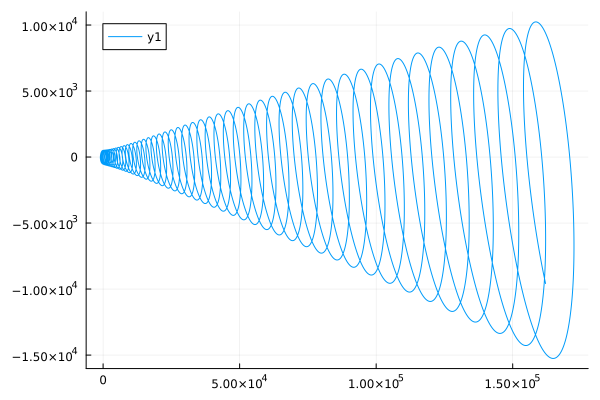

In [144]:
plot(X_arr[8,:],X_arr[7,:])

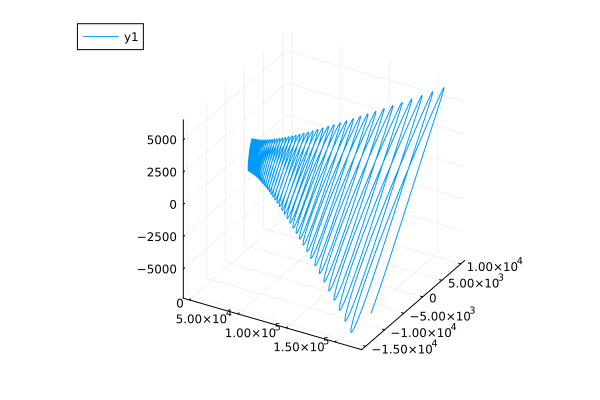

In [140]:
plot(X_arr[8,:],X_arr[7,:],X_arr[9,:])